<a href="https://colab.research.google.com/github/EliseuODaniel/smart_cities/blob/main/acidentes_transito2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Análise do dataset de Acidentes em Rodovias Federais do Brasil

Dataset disponível em: https://www.kaggle.com/mcamera/brazil-highway-traffic-accidents/version/7

## 1 - Tratamento dos Dados

In [115]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [116]:
# Carregando os módulos e pacotes
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime as dt 
%matplotlib inline

In [117]:
# Carregando os datasets sobre as ocorrências dos acidentes
df2017 = pd.read_csv('/content/drive/MyDrive/smart cities/datatran2017.csv', sep = ';', encoding = 'latin-1', decimal=',', parse_dates=['data_inversa', 'horario'])
df2018 = pd.read_csv('/content/drive/MyDrive/smart cities/datatran2017.csv', sep = ';', encoding = 'latin-1', decimal=',', parse_dates=['data_inversa', 'horario'])
df2019 = pd.read_csv('/content/drive/MyDrive/smart cities/datatran2017.csv', sep = ';', encoding = 'latin-1', decimal=',', parse_dates=['data_inversa', 'horario'])
df2020 = pd.read_csv('/content/drive/MyDrive/smart cities/datatran2017.csv', sep = ';', encoding = 'latin-1', decimal=',', parse_dates=['data_inversa', 'horario'])
df2021 = pd.read_csv('/content/drive/MyDrive/smart cities/datatran2017.csv', sep = ';', encoding = 'latin-1', decimal=',', parse_dates=['data_inversa', 'horario'])

# Unir os dados em um único dataset
# Limpe o índice existente e redefina-o no resultado definindo a opção ignore_index como True.
ocorrencias = pd.concat([df2017,df2018,df2019,df2020,df2021], ignore_index=True)

In [118]:
# Excluindo algumas colunas do DataFrame
ocorrencias = ocorrencias.drop(['id', 'fase_dia', 'km', 'sentido_via', 'tracado_via', 'uso_solo', 'pessoas', 'mortos', 'feridos_leves', 'feridos_graves', 
                                'ilesos', 'ignorados', 'feridos', 'veiculos', 'regional', 'delegacia', 'uop'], axis=1)

# Criando duas novas colunas 'mes' e 'ano'
ocorrencias.insert(1, 'mes', 0)
ocorrencias.insert(2, 'ano', 0)

ocorrencias['mes'] = ocorrencias['data_inversa'].dt.month
ocorrencias['ano'] = ocorrencias['data_inversa'].dt.year
ocorrencias['horario'] = ocorrencias['horario'].dt.hour

# Selecionando somente os acidentes ocorridos no estado de SC
ocorrencias = ocorrencias.loc[ocorrencias['uf'] == 'SC']
ocorrencias

,data_inversa,mes,ano,dia_semana,horario,uf,br,municipio,causa_acidente,tipo_acidente,classificacao_acidente,condicao_metereologica,tipo_pista,latitude,longitude
1,2017-01-01,1,2017,domingo,0,SC,101.0,PALHOCA,Falta de Atenção à Condução,Colisão com objeto estático,Sem Vítimas,Chuva,Dupla,-27.810100,-48.635700
4,2017-01-01,1,2017,domingo,0,SC,280.0,CORUPA,Ingestão de Álcool,Saída de leito carroçável,Com Vítimas Feridas,Chuva,Simples,-26.446752,-49.201670
14,2017-01-01,1,2017,domingo,1,SC,101.0,BIGUACU,Velocidade Incompatível,Saída de leito carroçável,Com Vítimas Feridas,Chuva,Dupla,-27.464225,-48.641842
15,2017-01-01,1,2017,domingo,2,SC,101.0,JOINVILLE,Ingestão de Álcool,Colisão traseira,Com Vítimas Feridas,Chuva,Dupla,-26.348700,-48.857400
21,2017-01-01,1,2017,domingo,1,SC,280.0,TRES BARRAS,Ingestão de Álcool,Colisão traseira,Sem Vítimas,Nublado,Simples,-26.183500,-50.336936
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447639,2017-05-07,5,2017,domingo,2,SC,101.0,ARAQUARI,Condutor Dormindo,Saída de leito carroçável,Com Vítimas Feridas,Nevoeiro/Neblina,Dupla,-26.480753,-48.736811
447680,2017-10-08,10,2017,domingo,21,SC,282.0,IRACEMINHA,Falta de Atenção à Condução,Colisão frontal,Com Vítimas Feridas,Nublado,Simples,-26.818754,-53.365486
447769,2017-08-16,8,2017,quarta-feira,19,SC,101.0,BALNEARIO CAMBORIU,Defeito Mecânico no Veículo,Tombamento,Com Vítimas Feridas,Ignorado,Dupla,-26.984076,-48.669771
447777,2017-10-21,10,2017,sábado,0,SC,101.0,SANTA ROSA DO SUL,Falta de Atenção à Condução,Colisão transversal,Com Vítimas Fatais,Ignorado,Dupla,-29.179800,-49.754700


In [119]:
# Resumo de informações sobre o DataFrame, como quantidade de linhas, quantidade de colunas, nomes das colunas, etc.
ocorrencias.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53325 entries, 1 to 447787
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   data_inversa            53325 non-null  datetime64[ns]
 1   mes                     53325 non-null  int64         
 2   ano                     53325 non-null  int64         
 3   dia_semana              53325 non-null  object        
 4   horario                 53325 non-null  int64         
 5   uf                      53325 non-null  object        
 6   br                      53230 non-null  float64       
 7   municipio               53325 non-null  object        
 8   causa_acidente          53325 non-null  object        
 9   tipo_acidente           53325 non-null  object        
 10  classificacao_acidente  53325 non-null  object        
 11  condicao_metereologica  53325 non-null  object        
 12  tipo_pista              53325 non-null  objec

In [120]:
# Eliminando os dados faltantes
ocorrencias.dropna(inplace=True)

In [121]:
# Remoção de latitudes e longitudes outliers
ocorrencias = ocorrencias[ocorrencias['latitude'] < -26 ]
ocorrencias = ocorrencias[ocorrencias['longitude'] > -54]

In [122]:
ocorrencias = ocorrencias.iloc[5:,]

In [123]:
# Resumo de informações sobre o DataFrame tratado, como quantidade de linhas, quantidade de colunas, nomes das colunas, etc.
ocorrencias.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 53065 entries, 24 to 447787
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype         
---  ------                  --------------  -----         
 0   data_inversa            53065 non-null  datetime64[ns]
 1   mes                     53065 non-null  int64         
 2   ano                     53065 non-null  int64         
 3   dia_semana              53065 non-null  object        
 4   horario                 53065 non-null  int64         
 5   uf                      53065 non-null  object        
 6   br                      53065 non-null  float64       
 7   municipio               53065 non-null  object        
 8   causa_acidente          53065 non-null  object        
 9   tipo_acidente           53065 non-null  object        
 10  classificacao_acidente  53065 non-null  object        
 11  condicao_metereologica  53065 non-null  object        
 12  tipo_pista              53065 non-null  obje

## 2 - Visualização dos Dados

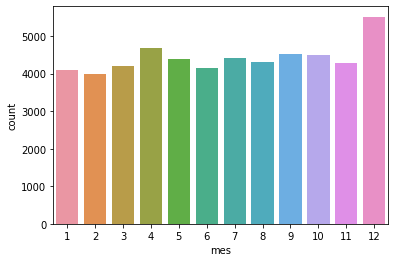

In [124]:
# Gráfico de barra mostrando o número de acidentes em relação aos meses do ano
sns.countplot(x='mes', data=ocorrencias)

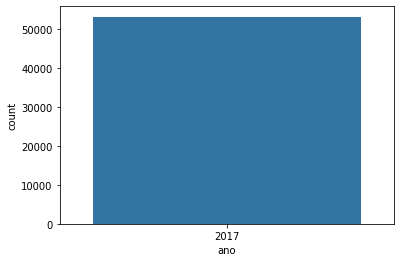

In [125]:
# Gráfico de barra mostrando o número de acidentes em relação aos anos de 2017 a 2021
sns.countplot(x='ano', data=ocorrencias)

(array([0, 1, 2, 3, 4, 5, 6]), <a list of 7 Text major ticklabel objects>)

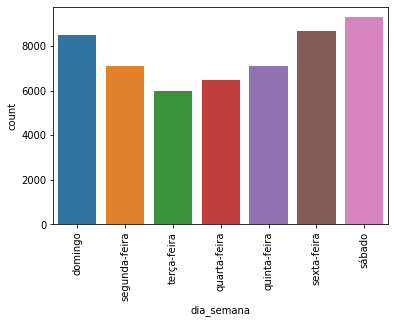

In [126]:
# Gráfico de barra mostrando o número de acidentes em relação aos dias da semana
sns.countplot(x='dia_semana', data=ocorrencias)
plt.xticks(rotation=90)

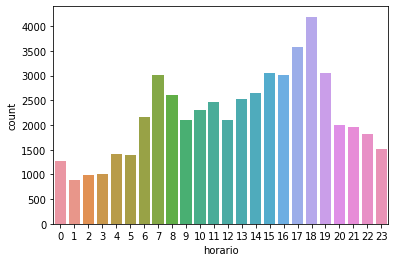

In [127]:
# Gráfico de barras mostrando o número de acidentes em relação ao horário
sns.countplot(x='horario', data=ocorrencias)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 <a list of 9 Text major ticklabel objects>)

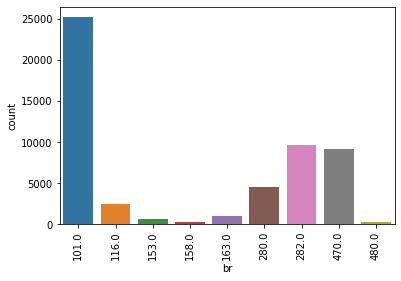

In [128]:
# Gráfico de barra mostrando o número de acidentes em relação às rodovias
sns.countplot(x='br', data=ocorrencias)
plt.xticks(rotation=90)

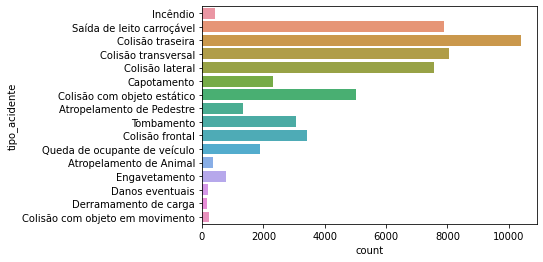

In [129]:
# Gráfico de barra mostrando o número de acidentes em relação ao tipo
sns.countplot(y='tipo_acidente', data=ocorrencias)

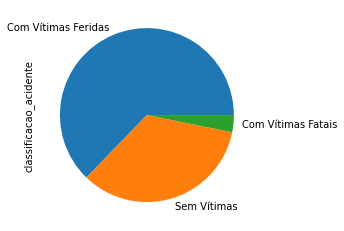

In [130]:
# Gráfico de setores mostrando o número de acidentes em relação as classificações do acidente 
ocorrencias['classificacao_acidente'].value_counts().plot(kind='pie')

(array([0, 1, 2, 3, 4, 5, 6, 7]), <a list of 8 Text major ticklabel objects>)

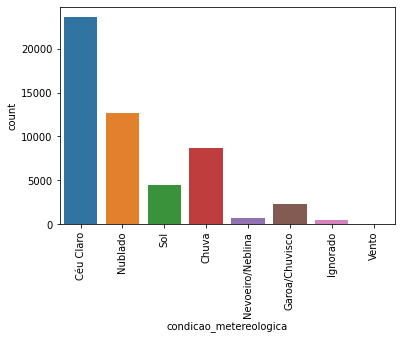

In [131]:
# Gráfico de barra mostrando o número de acidentes em relação as condições metereológicas
sns.countplot(x='condicao_metereologica', data=ocorrencias)
plt.xticks(rotation=90)

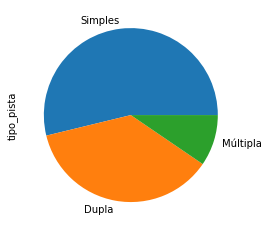

In [132]:
# Gráfico de setores mostrando o número de acidentes em relação aos tipos de pista
ocorrencias['tipo_pista'].value_counts().plot(kind='pie')

In [133]:
# Expressando porcentagens das ocorrências por causas do acidente
ocorrencias['causa_acidente'].value_counts(normalize=True)

Falta de Atenção à Condução                                                       0.428606
Velocidade Incompatível                                                           0.108245
Não guardar distância de segurança                                                0.087346
Ingestão de Álcool                                                                0.081165
Desobediência às normas de trânsito pelo condutor                                 0.077829
Defeito Mecânico no Veículo                                                       0.037784
Pista Escorregadia                                                                0.033355
Condutor Dormindo                                                                 0.031848
Ultrapassagem Indevida                                                            0.021954
Falta de Atenção do Pedestre                                                      0.017997
Avarias e/ou desgaste excessivo no pneu                                           0.014605

In [134]:
# Expressando porcentagens das ocorrências por municípios
ocorrencias['municipio'].value_counts(normalize=True)

SAO JOSE                  0.089419
PALHOCA                   0.072534
ITAJAI                    0.039386
JOINVILLE                 0.037671
BALNEARIO CAMBORIU        0.033450
                            ...   
BALNEARIO BARRA DO SUL    0.000283
LAURENTINO                0.000094
LUIZ ALVES                0.000094
MORRO DA FUMACA           0.000094
SAO BONIFACIO             0.000094
Name: municipio, Length: 117, dtype: float64

#### Plotagem de um gráfico mostrando no mapa os acidentes agrupados por quantidade


In [135]:
# Install folium package
import folium
from sklearn import preprocessing
import scipy
## for geospatial
import geopy
from folium.plugins import MarkerCluster

In [136]:

locations = ocorrencias[['latitude', 'longitude']]
locationlist = locations.values.tolist()
locationlist[7]

[-27.70775937, -48.95278403]

In [137]:
# Plotagem dos acidentes agrupados por quantidade

from folium.plugins import HeatMap


m = folium.Map(location=[-27.71624826, -48.86979461], zoom_start=7, control_scale=True)

HeatMap(locationlist).add_to(m)
  
m

#### Plotagem de uma amostra dos acidentes classificados por gravidade

In [138]:
# Criar coluna cor, correspondendo verde: sem vítimas, amarelo: com vítimas feridas e vermelho com vítimas fatais
colors = ["red","yellow", "green"]
indices = ['Com Vítimas Fatais', 'Com Vítimas Feridas', 'Sem Vítimas']
ocorrencias["cor"] = ocorrencias["classificacao_acidente"].apply(lambda x: 
               colors[indices.index(x)])

In [139]:
map3 = folium.Map(location=[-27.71624826, -48.86979461],
                  zoom_start=8)

In [140]:
ocorrencias_menor = ocorrencias.iloc[0:10000,]

ocorrencias_menor.apply(lambda row: folium.CircleMarker(
           location=[row['latitude'],row['longitude']], 
           popup=row['classificacao_acidente'],
           color=row["cor"], fill=True).add_to(map3), axis=1)

24       <folium.vector_layers.CircleMarker object at 0...
41       <folium.vector_layers.CircleMarker object at 0...
66       <folium.vector_layers.CircleMarker object at 0...
85       <folium.vector_layers.CircleMarker object at 0...
92       <folium.vector_layers.CircleMarker object at 0...
                               ...                        
84313    <folium.vector_layers.CircleMarker object at 0...
84319    <folium.vector_layers.CircleMarker object at 0...
84331    <folium.vector_layers.CircleMarker object at 0...
84339    <folium.vector_layers.CircleMarker object at 0...
84345    <folium.vector_layers.CircleMarker object at 0...
Length: 10000, dtype: object

In [141]:
# Plotagem de uma amostra dos acidentes classificados por gravidade
map3